## Trabalho Individual

##### Nome: Paulo Henrique Pianissola de Cerqueira
##### Número: PG52699

A escolha do dataset se deu pelo Vangogh2photo, um dataset onde possui as pinturas e desenhos do famoso pintor Van Gogh e um conjunto de fotos (256 x 256 pixels), a intenção principal é avaliar as funçoes de erro clássica e a função de erro Werstein.

O dataset é dividido em Train e Test, onde Train possui as pinturas de Van Gogh e possui as fotografias reais. O Test também possui ambos os dominios.

O dataset está disponível no sitio da Universidade da California Berkeley: <https://efrosgans.eecs.berkeley.edu/cyclegan/datasets/>
 

Primeiramente são feitos os imports, diversas bibliotecas foram utilizadas como o PIL, Torch e suas sub blibliotecas (Torchvision e nn), matplotlib, numpy e os.

In [1]:
import os
from PIL import Image
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch
import torch.nn as nn
import itertools
import torch.optim as optim
import matplotlib.pyplot as plt

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


Abaixo, foi definido uma classe personalizada *ImageDataset* que herda de *torch.utils.data.Dataset*, a classe base para todos os datasets no PyTorch. O objetivo dessa classe é carregar imagens dos dois diretórios diferentes, A e B, aplicando transformações específicas a essas imagens antes de retorná-las como um dicionário. 

Na inicialização, a classe recebe o caminho onde os dados estão armazenados, uma lista de transformações (*transforms_*) a serem aplicadas e o modo (*mode*), que pode ser *'train'* ou *'test'*. Dentro do método __getitem__, a imagem correspondente do diretório A e a imagem correspondente do diretório B são carregadas, transformadas e retornadas como um dicionário contendo item_A e item_B.

Além disso, o código define uma série de transformações a serem aplicadas às imagens, incluindo redimensionamento, recorte aleatório, inversão horizontal aleatória, conversão para tensor e normalização dos valores dos pixels. Essas transformações são compostas usando *transforms.Compose()*. O dataset é então carregado utilizando a classe *ImageDataset* e é passado para um *DataLoader* do *PyTorch*, que facilita a iteração sobre o *dataset* em lotes (*batch_size=1*) e permite embaralhamento das imagens a cada epoch (*shuffle=True*). O *DataLoader* é essencial para alimentar o modelo de aprendizado de máquina com os dados de treino de forma eficiente.

In [3]:
class ImageDataset(Dataset):
    def __init__(self, root, transforms_=None, mode='train'):
        self.transform = transforms.Compose(transforms_)
        self.files_A = sorted(os.listdir(os.path.join(root, f'{mode}A')))
        self.files_B = sorted(os.listdir(os.path.join(root, f'{mode}B')))
        self.root = root
        self.mode = mode

    def __getitem__(self, index):
        image_A = Image.open(os.path.join(self.root, f'{self.mode}A', self.files_A[index % len(self.files_A)]))
        image_B = Image.open(os.path.join(self.root, f'{self.mode}B', self.files_B[index % len(self.files_B)]))

        item_A = self.transform(image_A)
        item_B = self.transform(image_B)
        
        return {'A': item_A, 'B': item_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

# Define the transformations
transforms_ = [
    transforms.Resize(int(256 * 1.12), Image.BICUBIC),
    transforms.RandomCrop(256),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]

# Load the dataset
dataloader = DataLoader(ImageDataset(root='./dataset/vangogh2photo/Train', transforms_=transforms_), batch_size=1, shuffle=True)



Na celula abaixo é definida a estrutura do gerador e descriminador para uma rede CycleGAN que é utilizada para transferencia de estilo entre dois dominios diferentes de imagens.

__Generator__: é o responsável por transformar a imagem de um dominio para outro. Consiste em diversas camadas, a primeira delas faz a convolução com kernel 7x7, em seguida aplica a normalização através da ReLU. Após este procedimento é aplicado o *downsampling*, para reduzir as imagens dobrando o numero de filtros.

A parte central do gerador é composta por um número especificado de blocos residuais (*n_residual_blocks*), que ajudam a manter a identidade da imagem e melhorar a qualidade da geração. Finalmente, duas camadas de upsampling aumentam novamente a dimensão espacial das imagens, e uma camada final de convolução com kernel de 7x7 ajusta a imagem gerada ao formato de saída desejado, utilizando a função de ativação Tanh para normalizar os valores dos pixels entre -1 e 1.

__Discriminador__: classe responsável por distinguir entre imagens reais e imagens geradas. Sua arquitetura consiste em diversas camadas de convolução. A primeira camada aplica uma convolução 4x4 e stride 2, seguida de uma ativação LeakyReLU. A ultima camada reduz a dimensão espacial para 1x1, com uma unica unidade de saida que representa a decisão do discriminador, sendo a imagem real ou falsa. 

Nas camadas intermediárias, a função de ativação LeakyReLU ajuda a evitar o problema de *"vanishing gradients"* durante o treinamento, que é quando os gradientes que são utilizados para fazer a atualização da rede ficam tão pequenos ou *"vanish"* quando é feito o *backpropagation* das *layers* finais para as anteriores.

In [4]:
# Define the generator
class Generator(nn.Module):
    def __init__(self, input_nc, output_nc, n_residual_blocks=9):
        super(Generator, self).__init__()

        # Initial layer
        model = [nn.Conv2d(input_nc, 64, kernel_size=7, stride=1, padding=3, bias=False),
                 nn.InstanceNorm2d(64),
                 nn.ReLU(inplace=True)]

        # Downsampling
        in_features = 64
        out_features = in_features * 2
        for _ in range(2):
            model += [nn.Conv2d(in_features, out_features, kernel_size=3, stride=2, padding=1, bias=False),
                      nn.InstanceNorm2d(out_features),
                      nn.ReLU(inplace=True)]
            in_features = out_features
            out_features = in_features * 2

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResidualBlock(in_features)]

        # Upsampling
        out_features = in_features // 2
        for _ in range(2):
            model += [nn.ConvTranspose2d(in_features, out_features, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False),
                      nn.InstanceNorm2d(out_features),
                      nn.ReLU(inplace=True)]
            in_features = out_features
            out_features = in_features // 2

        # Final layer
        model += [nn.Conv2d(64, output_nc, kernel_size=7, stride=1, padding=3),
                  nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

# Define the residual block
class ResidualBlock(nn.Module):
    def __init__(self, features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.Conv2d(features, features, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(features),
            nn.ReLU(inplace=True),
            nn.Conv2d(features, features, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(features)
        )

    def forward(self, x):
        return x + self.block(x)

# Define the discriminator
class Discriminator(nn.Module):
    def __init__(self, input_nc):
        super(Discriminator, self).__init__()

        model = [nn.Conv2d(input_nc, 64, kernel_size=4, stride=2, padding=1),
                 nn.LeakyReLU(0.2, inplace=True)]
        
        model += [nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
                  nn.InstanceNorm2d(128),
                  nn.LeakyReLU(0.2, inplace=True)]
        
        model += [nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
                  nn.InstanceNorm2d(256),
                  nn.LeakyReLU(0.2, inplace=True)]
        
        model += [nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=1),
                  nn.InstanceNorm2d(512),
                  nn.LeakyReLU(0.2, inplace=True)]
        
        model += [nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)



#### FUNÇÕES DE ERRO

Na primeira celula é definida a loss classica, com 3 funções conforme abaixo:
1. criterion_GAN: É a perda do erro quadratico médio, utilizada para o treinamento dos discriminadores. Mede a diferença entre as previsoes do discriminador e os rotulos reais, penalizando fortemente as previsões erradas.
2. criterion_cycle: A perda L1 é utilizada para a consistentcia de ciclo. Ela mede a diferença absoluta média entre a imagem original e a imagem reconstruida após duas transformaçoes incentivando o modelo a preservar a identidade da imagem original.
3. criterion_identity: Também utiliza a perda L1 para garantir que as imagens que já estão no dominio alvo permaneçam inalteradas quando passadas pelo gerador correspondente, isso ajuda a estabilizar o treinamento e manter as caracteristicas essenciais das imagens.

In [5]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

A perda wasserstein é uma alternativa a MSE ou BSE para as GANs, ela mede a divergencia Wasserstein entre a distribuição gerada e a distribuição real.

Este modelo foi proposto por Martin Arjovsky em seu paper em 2017 que tem o titulo de *"Wasserstein GAN"*. No paper é sugerido que ao invés de fazer o discriminador categorizar as imagens como sendo autenticas ou falsas, as WGAN substituem este modelo de discriminador por um crítico que tabula a veracidade ou falsidade de uma imagem. A vantagem deste modelo em relação as GANs tradicionais é que a WGAN permite um treinamento mais estável e uma geração de amostras mais diversificadas, já que nas GANs tradicionais pode não haver convergencia e o discriminador e gerador não conseguem melhorar suas habilidades ao longo do tempo.


In [6]:
def wasserstein_loss(y_true, y_pred):
    return torch.mean(y_true * y_pred)

#### TREINO

Abaixo encontra-se a célula de treinamento, onde são treinados os geradores e os discriminadores, foi escolhido o treinamento em 5 épocas pois há uma demora significativa de treinamento, devido ao hardware utilizado.

A cada duas épocas é mostrado o resultado durante o treinamento, é mostrado a imagem original de cada dominio e suas respectivas traduçoes usando as funções de perda classica e Wasserstein.

[Epoch 0/5] [Batch 0/12574] [D loss: 1.0168976485729218] [G loss: 8.782709121704102 / 7.313254356384277]
[Epoch 0/5] [Batch 1/12574] [D loss: 1.9856134355068207] [G loss: 8.106419563293457 / 7.72059965133667]
[Epoch 0/5] [Batch 2/12574] [D loss: 1.7127968668937683] [G loss: 9.052387237548828 / 7.8777995109558105]
[Epoch 0/5] [Batch 3/12574] [D loss: 1.7238045930862427] [G loss: 9.222131729125977 / 8.23574161529541]
[Epoch 0/5] [Batch 4/12574] [D loss: 1.1482602953910828] [G loss: 6.330206871032715 / 5.8377580642700195]
[Epoch 0/5] [Batch 5/12574] [D loss: 0.858091801404953] [G loss: 5.413995742797852 / 5.215265274047852]
[Epoch 0/5] [Batch 6/12574] [D loss: 0.6165288388729095] [G loss: 7.756435871124268 / 7.449775218963623]
[Epoch 0/5] [Batch 7/12574] [D loss: 1.064195990562439] [G loss: 8.15633487701416 / 7.5937299728393555]
[Epoch 0/5] [Batch 8/12574] [D loss: 0.7465891540050507] [G loss: 5.305969715118408 / 5.017758369445801]
[Epoch 0/5] [Batch 9/12574] [D loss: 0.44892077147960663]

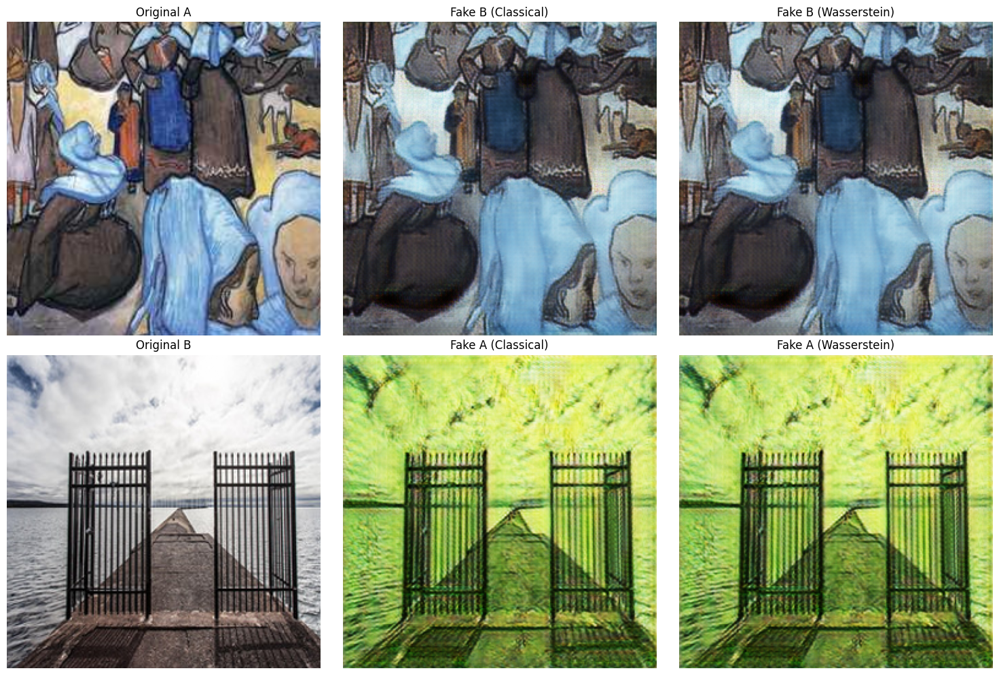

[Epoch 1/5] [Batch 0/12574] [D loss: 0.3144899681210518] [G loss: 2.764739513397217 / 2.4087324142456055]
[Epoch 1/5] [Batch 1/12574] [D loss: 0.3911348879337311] [G loss: 2.2132725715637207 / 2.332752227783203]
[Epoch 1/5] [Batch 2/12574] [D loss: 0.1355183869600296] [G loss: 2.8420662879943848 / 2.7431790828704834]
[Epoch 1/5] [Batch 3/12574] [D loss: 0.2857606112957001] [G loss: 2.764939308166504 / 2.6325013637542725]
[Epoch 1/5] [Batch 4/12574] [D loss: 0.2791062146425247] [G loss: 1.9522418975830078 / 2.033519744873047]
[Epoch 1/5] [Batch 5/12574] [D loss: 0.19001495838165283] [G loss: 2.3069469928741455 / 2.3379175662994385]
[Epoch 1/5] [Batch 6/12574] [D loss: 0.09164908528327942] [G loss: 2.0765016078948975 / 1.659164309501648]
[Epoch 1/5] [Batch 7/12574] [D loss: 0.13047876209020615] [G loss: 2.7042839527130127 / 2.233896017074585]
[Epoch 1/5] [Batch 8/12574] [D loss: 0.1809035763144493] [G loss: 1.9964368343353271 / 1.7555928230285645]
[Epoch 1/5] [Batch 9/12574] [D loss: 0.2

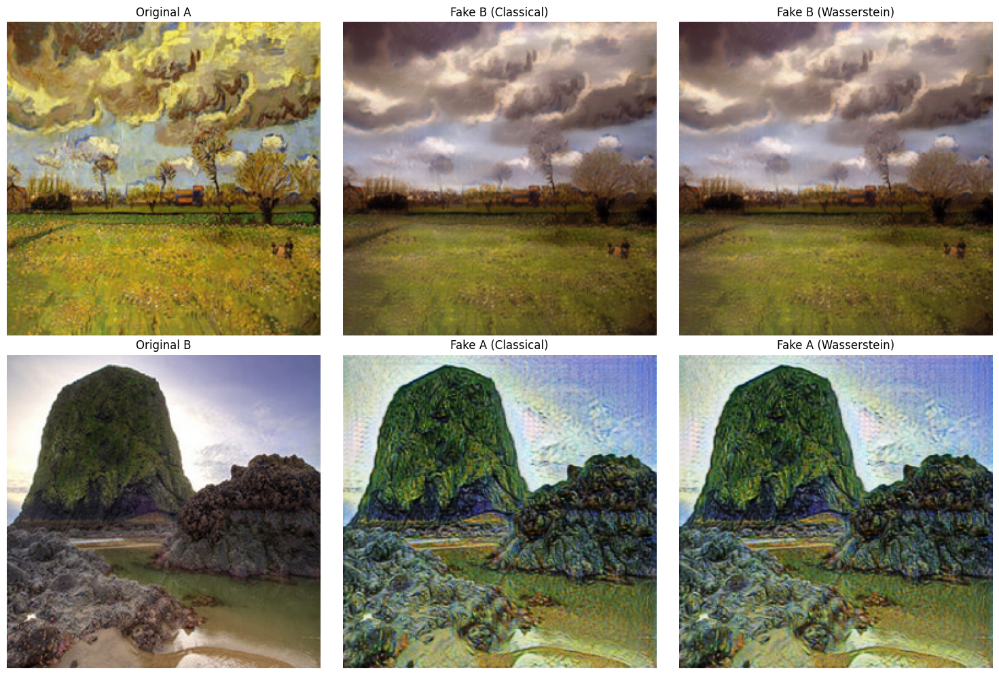

[Epoch 3/5] [Batch 0/12574] [D loss: 0.2108447402715683] [G loss: 1.766920804977417 / 1.6014864444732666]
[Epoch 3/5] [Batch 1/12574] [D loss: 0.3090052753686905] [G loss: 1.8214820623397827 / 2.0857081413269043]
[Epoch 3/5] [Batch 2/12574] [D loss: 0.40055854618549347] [G loss: 1.8295180797576904 / 1.8424255847930908]
[Epoch 3/5] [Batch 3/12574] [D loss: 0.14130505919456482] [G loss: 2.2344019412994385 / 1.674373745918274]
[Epoch 3/5] [Batch 4/12574] [D loss: 0.37565159797668457] [G loss: 2.2342357635498047 / 2.090301752090454]
[Epoch 3/5] [Batch 5/12574] [D loss: 0.2506817504763603] [G loss: 2.1767184734344482 / 1.978224277496338]
[Epoch 3/5] [Batch 6/12574] [D loss: 0.3220531940460205] [G loss: 1.9174859523773193 / 1.591270923614502]
[Epoch 3/5] [Batch 7/12574] [D loss: 0.4304388463497162] [G loss: 1.4909248352050781 / 1.8000566959381104]
[Epoch 3/5] [Batch 8/12574] [D loss: 0.18729795515537262] [G loss: 1.5883922576904297 / 1.5753979682922363]
[Epoch 3/5] [Batch 9/12574] [D loss: 0

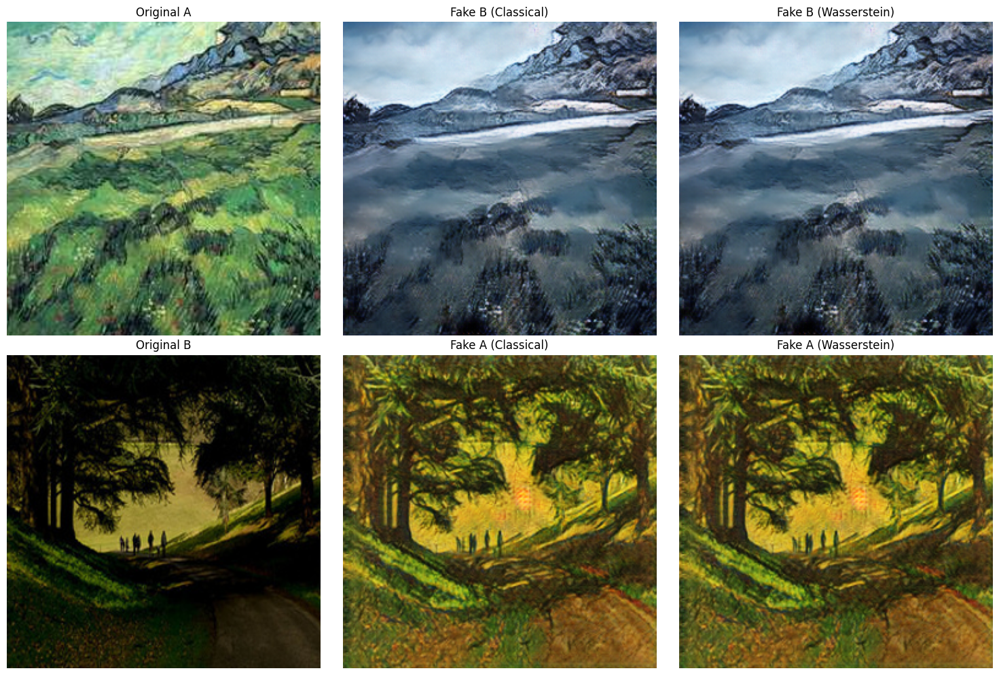

In [7]:
# Initialize the generators and discriminators
G_A2B = Generator(input_nc=3, output_nc=3).to(device)
G_B2A = Generator(input_nc=3, output_nc=3).to(device)
D_A = Discriminator(input_nc=3).to(device)
D_B = Discriminator(input_nc=3).to(device)

G_losses_classic = []
G_losses_wasserstein = []
D_A_losses = []
D_B_losses = []

# Initialize the optimizers
optimizer_G = optim.Adam(itertools.chain(G_A2B.parameters(), G_B2A.parameters()), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Tensors for the labels
real_label = torch.ones((1, 1, 30, 30)).to(device)
fake_label = torch.zeros((1, 1, 30, 30)).to(device)

n_epochs = 5

def save_image(image, path):
    image = image * 0.5 + 0.5  # Unnormalize
    np_image = image.cpu().detach().numpy()
    plt.imsave(path, np.transpose(np_image, (1, 2, 0)))

def show_images(epoch, real_A, fake_B_classic, fake_B_wasserstein, real_B, fake_A_classic, fake_A_wasserstein):
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    # Display one specific image from domain A and its translations
    axs[0, 0].imshow(np.transpose(real_A[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[0, 0].set_title('Original A')
    axs[0, 1].imshow(np.transpose(fake_B_classic[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[0, 1].set_title('Fake B (Classical)')
    axs[0, 2].imshow(np.transpose(fake_B_wasserstein[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[0, 2].set_title('Fake B (Wasserstein)')

    # Display one specific image from domain B and its translations
    axs[1, 0].imshow(np.transpose(real_B[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[1, 0].set_title('Original B')
    axs[1, 1].imshow(np.transpose(fake_A_classic[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[1, 1].set_title('Fake A (Classical)')
    axs[1, 2].imshow(np.transpose(fake_A_wasserstein[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
    axs[1, 2].set_title('Fake A (Wasserstein)')

    for ax in axs.flat:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

for epoch in range(n_epochs):
    for i, batch in enumerate(dataloader):
        real_A = batch['A'].to(device)
        real_B = batch['B'].to(device)

        # Train the generators
        optimizer_G.zero_grad()

        # Identity loss
        loss_id_A = criterion_identity(G_B2A(real_A), real_A)
        loss_id_B = criterion_identity(G_A2B(real_B), real_B)
        
        loss_identity = (loss_id_A + loss_id_B) / 2

        # GAN loss (classical)
        fake_B_classic = G_A2B(real_A)
        pred_fake = D_B(fake_B_classic)
        loss_GAN_A2B_classic = criterion_GAN(pred_fake, real_label)

        fake_A_classic = G_B2A(real_B)
        pred_fake = D_A(fake_A_classic)
        loss_GAN_B2A_classic = criterion_GAN(pred_fake, real_label)

        loss_GAN_classic = (loss_GAN_A2B_classic + loss_GAN_B2A_classic) / 2

        # GAN loss (Wasserstein)
        fake_B_wasserstein = G_A2B(real_A)
        pred_fake = D_B(fake_B_wasserstein)
        loss_GAN_A2B_wasserstein = wasserstein_loss(pred_fake, real_label)

        fake_A_wasserstein = G_B2A(real_B)
        pred_fake = D_A(fake_A_wasserstein)
        loss_GAN_B2A_wasserstein = wasserstein_loss(pred_fake, real_label)

        loss_GAN_wasserstein = (loss_GAN_A2B_wasserstein + loss_GAN_B2A_wasserstein) / 2

        # Cycle consistency loss
        recovered_A = G_B2A(fake_B_classic)
        loss_cycle_A = criterion_cycle(recovered_A, real_A)

        recovered_B = G_A2B(fake_A_classic)
        loss_cycle_B = criterion_cycle(recovered_B, real_B)

        loss_cycle = (loss_cycle_A + loss_cycle_B) / 2

        # Total generator loss
        loss_G_classic = loss_GAN_classic + 10.0 * loss_cycle + 5.0 * loss_identity
        loss_G_wasserstein = loss_GAN_wasserstein + 10.0 * loss_cycle + 5.0 * loss_identity

        loss_G_classic.backward(retain_graph=True)
        optimizer_G.step()

        # Train the discriminator A
        optimizer_D_A.zero_grad()

        pred_real = D_A(real_A)
        loss_D_real = criterion_GAN(pred_real, real_label)

        pred_fake = D_A(fake_A_classic.detach())
        loss_D_fake_classic = criterion_GAN(pred_fake, fake_label)

        pred_fake = D_A(fake_A_wasserstein.detach())
        loss_D_fake_wasserstein = wasserstein_loss(pred_fake, fake_label)

        loss_D_A = (loss_D_real + loss_D_fake_classic + loss_D_fake_wasserstein) / 3
        loss_D_A.backward()
        optimizer_D_A.step()

        # Train the discriminator B
        optimizer_D_B.zero_grad()

        pred_real = D_B(real_B)
        loss_D_real = criterion_GAN(pred_real, real_label)

        pred_fake = D_B(fake_B_classic.detach())
        loss_D_fake_classic = criterion_GAN(pred_fake, fake_label)

        pred_fake = D_B(fake_B_wasserstein.detach())
        loss_D_fake_wasserstein = wasserstein_loss(pred_fake, fake_label)

        loss_D_B = (loss_D_real + loss_D_fake_classic + loss_D_fake_wasserstein) / 3
        loss_D_B.backward()
        optimizer_D_B.step()

        # Store the losses
        G_losses_classic.append(loss_G_classic.item())
        G_losses_wasserstein.append(loss_G_wasserstein.item())
        D_A_losses.append(loss_D_A.item())
        D_B_losses.append(loss_D_B.item())

        # Print the losses
        print(f'[Epoch {epoch}/{n_epochs}] [Batch {i}/{len(dataloader)}] '
              f'[D loss: {loss_D_A.item() + loss_D_B.item()}] [G loss: {loss_G_classic.item()} / {loss_G_wasserstein.item()}]')
    
    # Show images
    if epoch % 2 == 0:  # Show images every 2 epochs
        show_images(epoch, real_A, fake_B_classic, fake_B_wasserstein, real_B, fake_A_classic, fake_A_wasserstein)



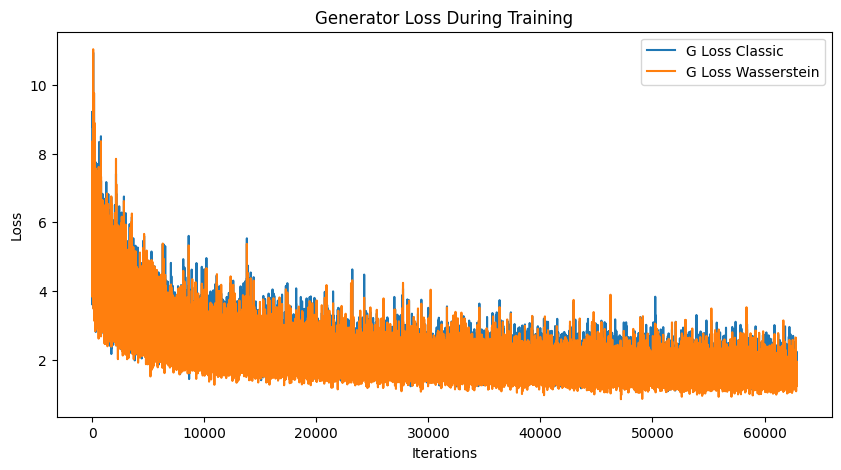

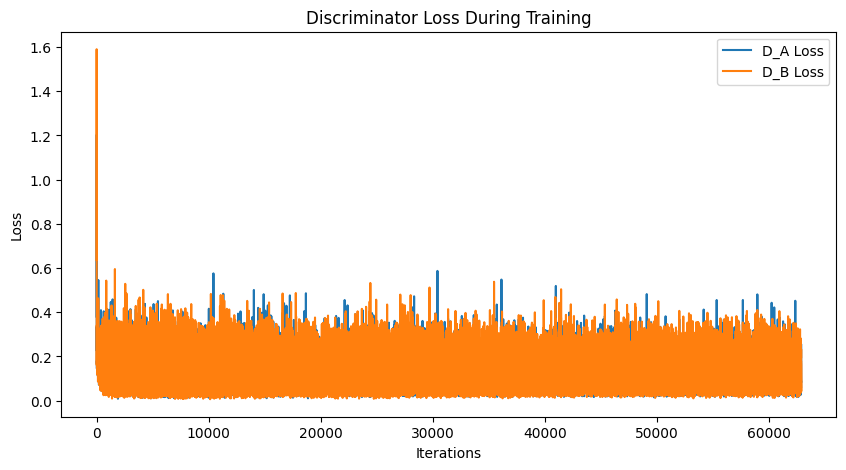

In [8]:
# Plotting the generator losses
plt.figure(figsize=(10, 5))
plt.title("Generator Loss During Training")
plt.plot(G_losses_classic, label="G Loss Classic")
plt.plot(G_losses_wasserstein, label="G Loss Wasserstein")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Plotting the discriminator losses
plt.figure(figsize=(10, 5))
plt.title("Discriminator Loss During Training")
plt.plot(D_A_losses, label="D_A Loss")
plt.plot(D_B_losses, label="D_B Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


Os graficos de Loss no gerador mostram uma tendencia decrescente ao longo das iterações o que indica que os geradores estão aprendendo a produzir imagens que enganam os os discriminadores cada vez melhor.

Já no discriminador mostram que este está aprendendo a diferenciar as imagens reais e falsas desde o começo. Após a fase inicial, a variabilidade é relativamente menor que nos geradores, o que é esperado, pois os discriminadores tendem a estabilizar mais rapidamente.

__Loss Clássica x Wasserstein__: A sobreposição das curvas de loss clássica e Wasserstein sugere que ambos os métodos estão conseguindo aprender eficientemente as representações, porém, devido a quantidade pequena de épocas executadas, a mudança não aparenta ser significativa neste momento.



#### TESTE

No inicio da função os geradores e discriminadores são colocados em modo de avaliação, o que é crucial para desativar comprotamentos especificos de treinamento como o dropout e os resultados de inferencia. Com o modo *eval()* o modelo opera de maneira consistente, refletindo a precisão com o que foi aprendido.

Para cada lote de dados no dataloader de teste as imagens reais dos dominios A e B são transformadas usando os geradores treinados para obter as imagens falsas. As previsões dos discriminadores para essas imagens geradas são calculadas para avaliar as predas GAN classia e Wasserstein.

Após o teste utilizamos a função do matplotlib para visualizar os resultados, as imagens são colocadas em um grid 2x3. Onde, similar ao treino, cada linha contem uma imagem original de um dominip e suas respectivas transformações utlizando as funções de perda classica e Wasserstein. as legendas das imagens transformadas incluem os valores das perdas correspondentes, permitindo uma comparação direta entre as duas perdas.

In [9]:
def load_test_data(root, transforms_):
    dataset = ImageDataset(root=root, transforms_=transforms_, mode='test')
    dataloader = DataLoader(dataset, batch_size=1, shuffle=True)
    return dataloader

In [10]:
def test_cycle_gan(G_A2B, G_B2A, D_A, D_B, dataloader, criterion_GAN, wasserstein_loss):
    G_A2B.eval()
    G_B2A.eval()
    D_A.eval()
    D_B.eval()

    for i, batch in enumerate(dataloader):
        real_A = batch['A'].to(device)
        real_B = batch['B'].to(device)

        with torch.no_grad():
            fake_B_classic = G_A2B(real_A)
            fake_A_classic = G_B2A(real_B)
            
            fake_B_wasserstein = G_A2B(real_A)
            fake_A_wasserstein = G_B2A(real_B)

            # Calcular as previsões do discriminador
            pred_fake_B_classic = D_B(fake_B_classic)
            pred_fake_A_classic = D_A(fake_A_classic)

            pred_fake_B_wasserstein = D_B(fake_B_wasserstein)
            pred_fake_A_wasserstein = D_A(fake_A_wasserstein)

            # Calcular as perdas
            loss_GAN_A2B_classic = criterion_GAN(pred_fake_B_classic, real_label)
            loss_GAN_B2A_classic = criterion_GAN(pred_fake_A_classic, real_label)
            loss_GAN_classic = (loss_GAN_A2B_classic + loss_GAN_B2A_classic) / 2

            loss_GAN_A2B_wasserstein = wasserstein_loss(pred_fake_B_wasserstein, real_label)
            loss_GAN_B2A_wasserstein = wasserstein_loss(pred_fake_A_wasserstein, real_label)
            loss_GAN_wasserstein = (loss_GAN_A2B_wasserstein + loss_GAN_B2A_wasserstein) / 2

        # Visualize the results
        fig, axs = plt.subplots(2, 3, figsize=(15, 10))

        axs[0, 0].imshow(np.transpose(real_A[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[0, 0].set_title('Original A')
        axs[0, 1].imshow(np.transpose(fake_B_classic[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[0, 1].set_title(f'Fake B (Classical) - Loss: {loss_GAN_classic.item():.4f}')
        axs[0, 2].imshow(np.transpose(fake_B_wasserstein[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[0, 2].set_title(f'Fake B (Wasserstein) - Loss: {loss_GAN_wasserstein.item():.4f}')

        axs[1, 0].imshow(np.transpose(real_B[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[1, 0].set_title('Original B')
        axs[1, 1].imshow(np.transpose(fake_A_classic[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[1, 1].set_title(f'Fake A (Classical) - Loss: {loss_GAN_classic.item():.4f}')
        axs[1, 2].imshow(np.transpose(fake_A_wasserstein[0].cpu().detach().numpy(), (1, 2, 0)) * 0.5 + 0.5)
        axs[1, 2].set_title(f'Fake A (Wasserstein) - Loss: {loss_GAN_wasserstein.item():.4f}')

        for ax in axs.flat:
            ax.axis('off')
        plt.tight_layout()
        plt.show()

        # Save images if needed
        #save_image(fake_B_classic[0], f'output/fake_B_classic_{i}.png')
        #save_image(fake_A_classic[0], f'output/fake_A_classic_{i}.png')
        #save_image(fake_B_wasserstein[0], f'output/fake_B_wasserstein_{i}.png')
        #save_image(fake_A_wasserstein[0], f'output/fake_A_wasserstein_{i}.png')

        # Limitar o número de imagens de teste visualizadas
        if i >= 5:
            break



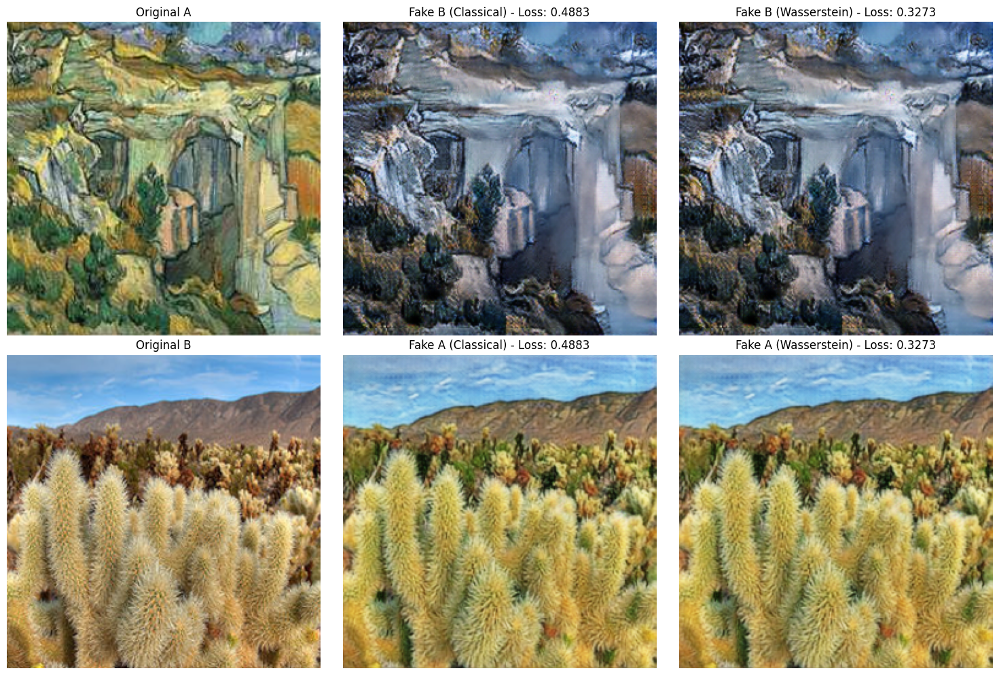

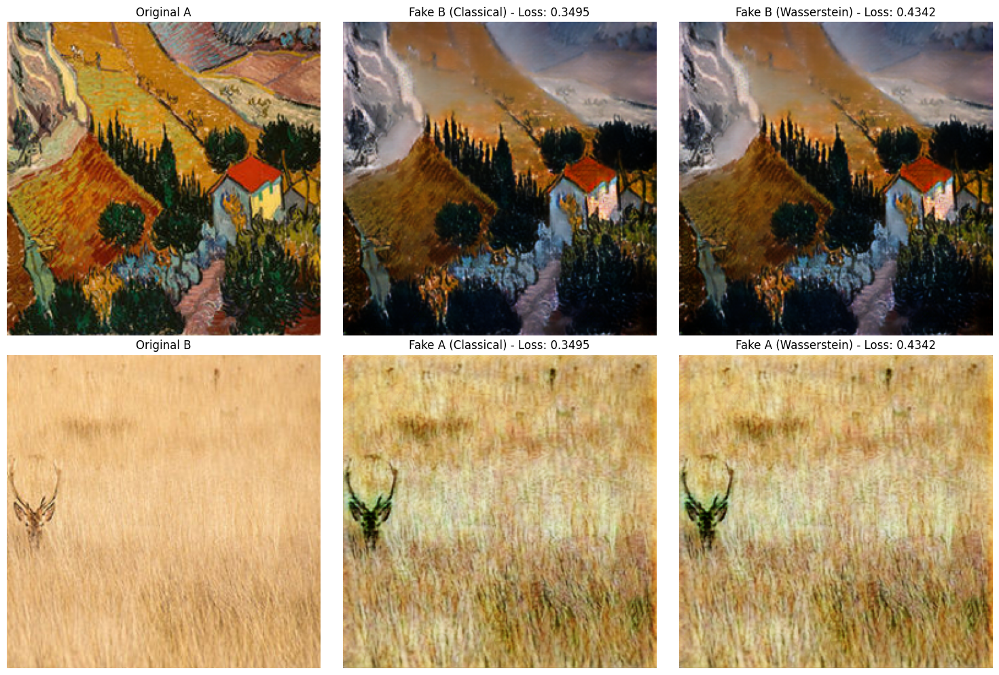

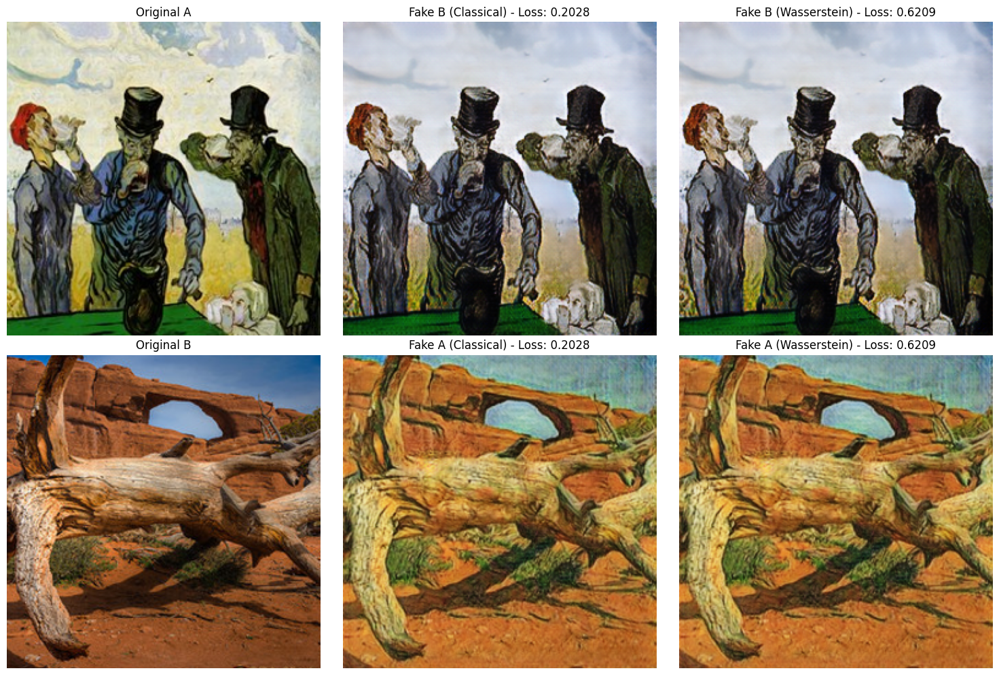

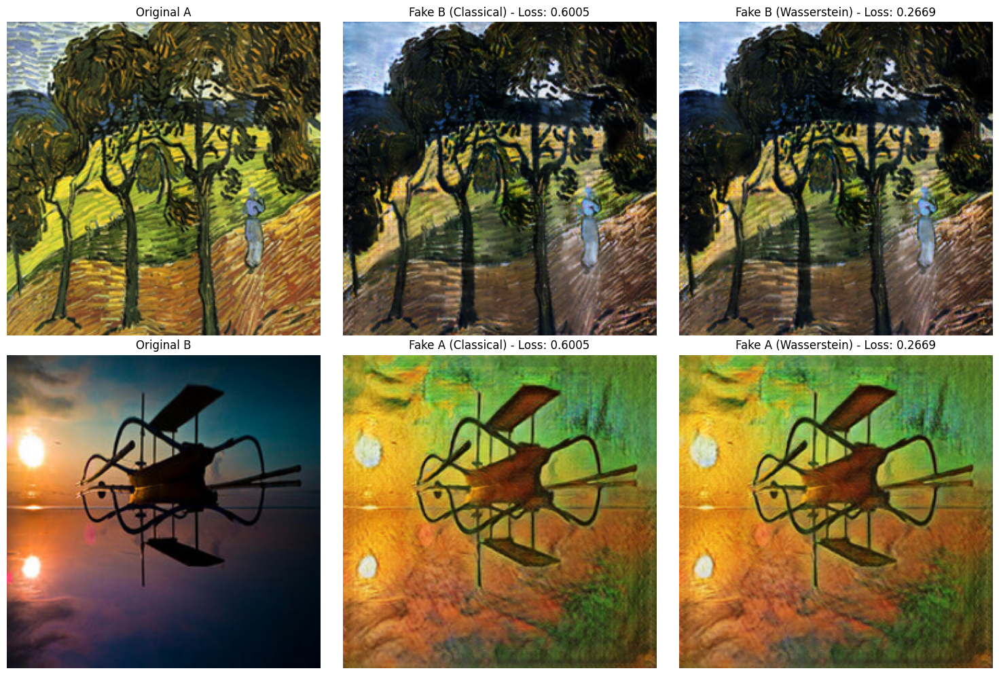

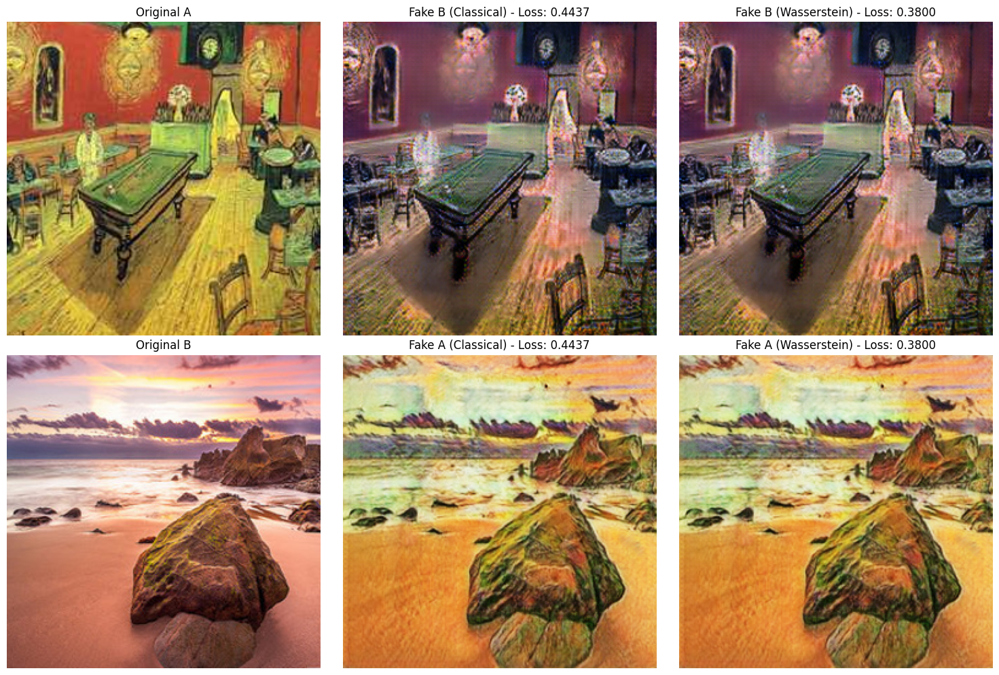

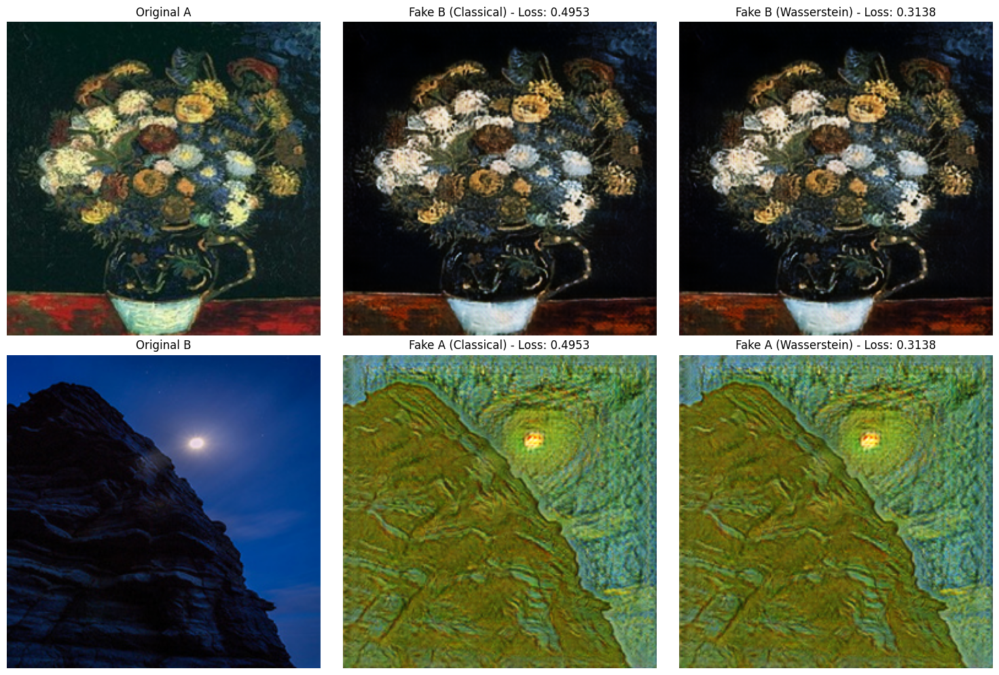

In [11]:
# Carregar dados de teste
test_dataloader = load_test_data(root='./dataset/vangogh2photo/Test', transforms_=transforms_)

# Testar o modelo treinado com cálculo da perda Wasserstein
test_cycle_gan(G_A2B, G_B2A, D_A, D_B, test_dataloader, criterion_GAN, wasserstein_loss)

#### Comparações das funções de erro

__Detalhes e Nitidez:__

As imagens geradas com a função de erro *Wasserstein* geralmente apresentam maior nitidez e melhor preservação dos detalhes em comparação com as geradas com a MSELoss. Isso é evidente nas texturas e nos contornos das imagens transformadas.

__Borragem e Suavidade:__

As imagens geradas utilizando a MSELoss tendem a ser mais suaves, o que pode resultar em uma aparência borrada. Esta suavidade pode ser benéfica para evitar artefatos visuais, mas também pode levar à perda de detalhes importantes.

__Artefatos Visuais:__

A função de erro Wasserstein pode introduzir alguns artefatos visuais que não são tão presentes nas imagens geradas com a MSELoss. Esses artefatos podem aparecer como padrões ou irregularidades nas áreas de transição das imagens.


#### CONCLUSÃO

As funções de erro MSE e Wasserstein oferecem diferentes vantagens e desvantagens no contexto de geração de imagens com CycleGAN. A MSELoss tende a produzir imagens mais suaves e menos propensas a artefatos, mas pode sacrificar a nitidez e os detalhes. A função de erro Wasserstein, por outro lado, pode produzir imagens mais detalhadas e nítidas, mas com um risco maior de introduzir artefatos visuais. A escolha da função de perda deve considerar o equilíbrio desejado entre suavidade e nitidez, bem como a tolerância a possíveis artefatos visuais nas imagens geradas. 

Durante o treinamento, a Wasserstein Loss oferece gradientes mais estáveis e consistentes, o que pode ajudar os modelos GAN a convergir de maneira mais eficaz para soluções que minimizam a distancia entre as distribuiçoes reais e geradas. Isso leva a um modelo que, no teste, produz previsões que estão mais proximas da distribuição real, resultando em uma Wasserstein Loss menor que a classica.

Devido ao treinamento ter ocorrido em somente 4 epocas, visto que o dataset é muito grande e o batch é de 1, as diferenças entre as imagens são muito sutís, ponto que com mais treinamento, a diferença apareceria maior. 